In [1]:
include("../05_countable_arms.jl")

(Any[ArmInfo(Main.MAB.Arms.Bernoulli(Bernoulli{Float64}(p=0.9)), 207, 0.9468599033816425), ArmInfo(Main.MAB.Arms.Bernoulli(Bernoulli{Float64}(p=0.9)), 153, 0.934640522875817)], [1, 2, 3, 3, 3, 4, 5, 6, 6, 6  …  8562, 8563, 8563, 8564, 8565, 8566, 8567, 8568, 8569, 8570])

In [2]:
total_time = 100000
repeats = 50

mean_rewards = collect(0.1:0.2:0.9)
alpha = 0.1
env = CABEnv(mean_rewards, [(1-alpha)/(length(mean_rewards)-1) .* ones(length(mean_rewards)-1); alpha], total_time)

CABEnv([0.1, 0.3, 0.5, 0.7, 0.9], [0.225, 0.225, 0.225, 0.225, 0.1], 100000)

In [3]:
mean_rewards

5-element Vector{Float64}:
 0.1
 0.3
 0.5
 0.7
 0.9

In [4]:
function run_adaptive_case(init_size, init_epsilon)
    total_rewards_ada = zeros(repeats, total_time)
    arm_size = []
    for i = 1:repeats
        alg = Algorithms.UCB1(init_size)
        arms, rewards = alg_adaptively_greedy(env, init_size, init_epsilon, alg)
        push!(arm_size, length(arms))
        total_rewards_ada[i,:] = rewards
    end 
    println(arm_size)
    return total_rewards_ada
end

run_adaptive_case (generic function with 1 method)

In [5]:
# adaptivly increase the candidate set with (epision-greedy)
results = []
p1 = plot()
for init_size in [trunc(Int, log(total_time) / alpha), trunc(Int, 1 / alpha),  trunc(Int, maximum([1/alpha, log(total_time)]))]
    for init_epsilon in [1, 1/alpha]
        rewards = run_adaptive_case(init_size, init_epsilon)
        push!(results, rewards)
        plot!(p1,1:total_time, maximum(mean_rewards) .* collect(1:total_time) - vec(mean(rewards, dims=1)),  label = "size = $init_size, epsilon = $init_epsilon", legend = :topleft)
    end
end
p1

Any[121, 120, 123, 122, 123, 122, 123, 126, 123, 119, 126, 125, 121, 124, 119, 122, 121, 121, 116, 129, 117, 119, 123, 120, 120, 122, 125, 123, 122, 124, 119, 119, 122, 121, 123, 124, 121, 116, 123, 120, 123, 121, 120, 125, 117, 123, 120, 121, 123, 119]
Any[178, 177, 171, 176, 185, 188, 183, 192, 184, 178, 171, 189, 189, 180, 193, 161, 191, 182, 175, 177, 176, 183, 178, 177, 169, 190, 183, 178, 193, 169, 195, 183, 172, 206, 170, 173, 199, 190, 188, 185, 190, 173, 190, 176, 177, 179, 198, 182, 187, 175]
Any[20, 27, 18, 20, 17, 22, 20, 19, 15, 18, 16, 19, 23, 15, 16, 19, 18, 20, 21, 19, 23, 22, 18, 28, 23, 18, 19, 17, 21, 22, 24, 20, 24, 27, 21, 17, 16, 19, 22, 19, 17, 18, 18, 19, 20, 16, 29, 19, 18, 17]
Any[102, 88, 105, 106, 104, 90, 86, 108, 110, 89, 109, 92, 109, 108, 103, 99, 100, 104, 109, 99, 99, 113, 106, 114, 97, 106, 104, 107, 95, 99, 115, 97, 100, 100, 111, 114, 97, 100, 107, 97, 110, 90, 102, 101, 122, 106, 116, 109, 99, 107]
Any[22, 24, 19, 15, 21, 28, 20, 19, 17, 18, 20, 19

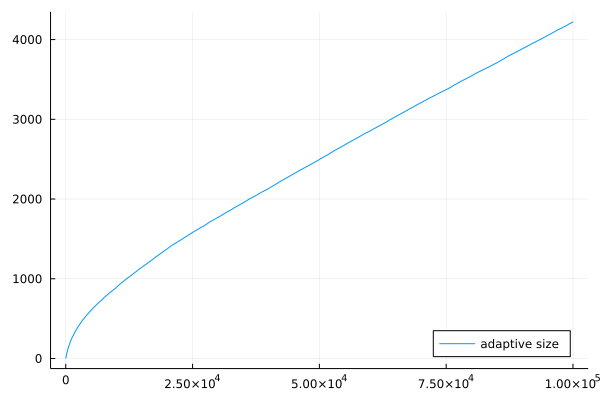

In [6]:
p = plot(1:total_time, maximum(mean_rewards) .* collect(1:total_time) - vec(mean(results[5],dims=1)),  label = "adaptive size", legend = :bottomright)


In [7]:
total_rewards_fix = zeros(repeats, total_time)
candidate_size = trunc(Int,log(total_time) / (2 * alpha)) 
for i = 1:repeats
    alg = Algorithms.UCB1(candidate_size)
    arms, rewards = alg_fixed_set(env,candidate_size , alg)
    total_rewards_fix[i,:] = rewards
end 

In [8]:
plot!(p, 1:total_time, maximum(mean_rewards) .* collect(1:total_time) - vec(mean(total_rewards_fix, dims=1)),  label = "fixed size", legend = :bottomright)

In [9]:
# arms, rewards = alg_elimination(env,candidate_size)

In [10]:
function run_elimination_case(init_size, pull_times, decay_ratio)
    total_rewards_elm = zeros(repeats, total_time)
    arm_size = []
    for i = 1:repeats
        alg = Algorithms.UCB1(init_size)
        arms, rewards = alg_elimination(env, init_size, pull_times, decay_ratio)
        push!(arm_size, length(arms))
        total_rewards_elm[i,:] = rewards
    end 
    println(arm_size)
    return total_rewards_elm
end

run_elimination_case (generic function with 1 method)

In [11]:
results = []
p3 = plot()
for init_size in [trunc(Int, log(total_time) / alpha), trunc(Int, 1 / alpha)]
    for pull_times in [ trunc(Int, log(total_time))]
        rewards = run_elimination_case(init_size, pull_times, 0.1)
        push!(results, rewards)
        plot!(p3,1:total_time, maximum(mean_rewards) .* collect(1:total_time) - vec(mean(rewards, dims=1)),  label = "size = $init_size, pull_times = $pull_times", legend = :topleft)
    end
end
p3

Any[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Any[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]


In [12]:
plot!(p, 1:total_time, maximum(mean_rewards) .* collect(1:total_time) - vec(mean(results[1], dims=1)),  label = "elimination", legend = :bottomright)